# WGAN with Gradient Penalty
## Training based on the paper "Improved Training on Wasserstein GAN - 2017"
Modification : Removed weight cliping from WGAN , and added penaly for Gradient norm to enforce 1-lipschitz constraint to get the correct the approximation of Wasserstein distance

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Code to preprocess the images before training.
from PIL import Image
import os
from concurrent.futures import ThreadPoolExecutor

def process_image(image_path, output_dir):
    try:
        image = Image.open(image_path)
        image = image.crop((25, 50, 153, 178))
        image = image.resize((64, 64))
        output_path = os.path.join(output_dir, os.path.basename(image_path))
        image.save(output_path)
        return f"Processed {os.path.basename(image_path)}"
    except Exception as e:
        return f"Error processing {os.path.basename(image_path)}: {e}"

# Use ThreadPoolExecutor to process images concurrently
def preprocess_images_parallel(root_dir, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    with ThreadPoolExecutor(max_workers=8) as executor:  # You can adjust the max_workers based on resources
        futures = []
        for root, _, files in os.walk(root_dir):
            for file in files:
                img_path = os.path.join(root, file)
                futures.append(executor.submit(process_image, img_path, output_dir))

        # Print results as they are completed
        for future in futures:
            print(future.result())

# Call the function to process images
preprocess_images_parallel('/content/drive/MyDrive/datasets/celeba/img_align_celeba/',
                           '/content/drive/MyDrive/datasets/celeba_preprocessed/')

In [ ]:
import os

# Paths
input_dir = '/content/drive/MyDrive/datasets/celeba/img_align_celeba/'
output_dir = '/content/drive/MyDrive/datasets/celeba_preprocessed/'

# Count files
input_files = len([name for name in os.listdir(input_dir) if os.path.isfile(os.path.join(input_dir, name))])
output_files = len([name for name in os.listdir(output_dir) if os.path.isfile(os.path.join(output_dir, name))])

print(f"Input folder contains: {input_files} files")
print(f"Output folder contains: {output_files} files")

Input folder contains: 0 files
Output folder contains: 23610 files


In [ ]:
from PIL import Image
from torch.utils.data import Dataset
class CelebADataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_files = os.listdir(root_dir)

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.image_files[idx])
        image = Image.open(img_path)

        if self.transform:
            image = self.transform(image)

        return image

dataset_path = '/content/drive/MyDrive/datasets/celeba_preprocessed/'

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard
class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.InstanceNorm2d(out_channels, affine = True), # LayerNorm ==> InstanceNorm
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        return self.disc(x)


class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            self._block(z_dim, features_g * 16, 4, 1, 0),
            self._block(features_g * 16, features_g * 8, 4, 2, 1),
            self._block(features_g * 8, features_g * 4, 4, 2, 1),
            self._block(features_g * 4, features_g * 2, 4, 2, 1),
            nn.ConvTranspose2d(features_g * 2, channels_img, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.gen(x)


def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


def gradient_penalty(critic, real, fake, device='cpu'):
  BATCH_SIZE, C,H, W = real.shape
  epsilon = torch.rand((BATCH_SIZE,1,1,1)).repeat(1,C,H,W).to(device)
  interpolated_images = real * epsilon + fake * (1 - epsilon)

  mixed_scores = critic(interpolated_images)

  gradient = torch.autograd.grad(inputs = interpolated_images, outputs = mixed_scores, grad_outputs = torch.ones_like(mixed_scores), create_graph = True,
                                 retain_graph = True)[0]
  gradient = gradient.view(gradient.shape[0],-1)
  gradient_norm = gradient.norm(2, dim=1)
  gradient_penalty = torch.mean((gradient_norm - 1)**2)
  return gradient_penalty


# Hyperparameters
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 1e-4
BATCH_SIZE = 64
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 5
FEATURES_DISC = 64
FEATURES_GEN = 64
CRITIC_ITERATION = 5
LAMBDA_GP = 10

transforms = transforms.Compose(
    [
        transforms.ToTensor(),
        transforms.Normalize([0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]),
    ]
)

# Dataset and loader
dataset = CelebADataset(root_dir=dataset_path, transform=transforms)
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True, persistent_workers=True)

gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
critic = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)
initialize_weights(gen)
initialize_weights(critic)

opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0,0.9))
opt_critic = optim.Adam(critic.parameters(), lr=LEARNING_RATE , betas= (0,0.9))

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)

writer_real = SummaryWriter(f"logs/real")
writer_fake = SummaryWriter(f"logs/fake")
step = 0

gen.train()
critic.train()

for epoch in range(NUM_EPOCHS):
    for batch_idx, real in enumerate(loader):
        real = real.to(device)
        # Train Critic
        for _ in range(CRITIC_ITERATION):
            noise = torch.randn(real.size(0), Z_DIM, 1, 1).to(device)
            fake = gen(noise)
            critic_real = critic(real).reshape(-1)
            critic_fake = critic(fake).reshape(-1)
            gp = gradient_penalty(critic, real, fake, device= device)
            loss_critic = (-(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP *gp )
            critic.zero_grad()
            loss_critic.backward(retain_graph=True)
            opt_critic.step()

        # Train Generator
        output = critic(fake).reshape(-1)
        loss_gen = -torch.mean(output)
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        if batch_idx % 100 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(loader)} "
                f"Loss D: {loss_critic:.4f}, loss G: {loss_gen:.4f}"
            )

            with torch.no_grad():
                fake = gen(fixed_noise)
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
                writer_real.add_image("Real", img_grid_real, global_step=step)
                writer_fake.add_image("Fake", img_grid_fake, global_step=step)

            step += 1

writer_fake.close()
writer_real.close()
%tensorboard --logdir=logs

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# Save the generator and critic model weights
torch.save(gen.state_dict(), "/content/drive/MyDrive/datasets/generator.pth")
torch.save(critic.state_dict(), "/content/drive/MyDrive/datasets/critic.pth")

<ipython-input-27-9dc391c0bc85>:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen.load_state_dict(torch.load("/content/drive/MyDrive/datasets/generator.pth"))


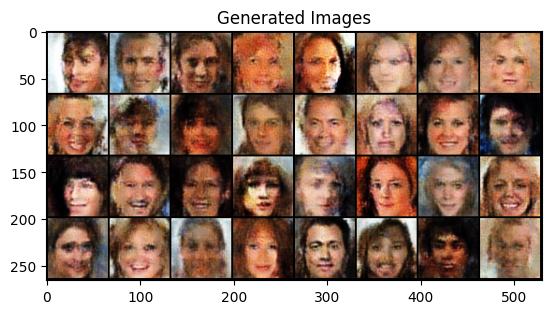

In [ ]:
import torch
import torchvision.utils as vutils

# Load the trained generator model
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
gen.load_state_dict(torch.load("/content/drive/MyDrive/datasets/generator.pth"))
gen.eval()  # Set the generator to evaluation mode

# Generate random noise
num_images = 32  # Number of images to generate
noise = torch.randn(num_images, Z_DIM, 1, 1).to(device)

# Generate images
with torch.no_grad():  # We don't need gradients for generating images
    fake_images = gen(noise)

import matplotlib.pyplot as plt
from torchvision.utils import make_grid

# Display generated images
grid = make_grid(fake_images, nrow=8, normalize=True)
plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
plt.title("Generated Images")
plt.show()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=logs

Output hidden; open in https://colab.research.google.com to view.